In [1]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
# other data viz packages: bokeh, plotly

from sklearn.model_selection import train_test_split

# Importing data

In [2]:
data = pd.read_csv("data/classificationdata.csv", index_col="id")
data.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17243 entries, 0 to 17242
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     17243 non-null  object 
 1   tenure                         17243 non-null  int64  
 2   contract_length                17196 non-null  float64
 3   promotions_offered             17196 non-null  object 
 4   remaining_term                 17196 non-null  float64
 5   last_nps_rating                17196 non-null  float64
 6   area_code                      17231 non-null  object 
 7   international_plan             17243 non-null  object 
 8   voice_mail_plan                17213 non-null  object 
 9   number_vmail_messages          17243 non-null  int64  
 10  total_day_minutes              17243 non-null  float64
 11  total_day_calls                17243 non-null  int64  
 12  total_day_charge               17243 non-null 

In [4]:
# splitting data
train, test = train_test_split(data, test_size=0.3, random_state=1234)

In [5]:
len(train) + len(test) == len(data)

True

# EDA

Looking into any trends in the data, and inspeting our target class in particular, as this is a classification task

In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12070 entries, 16692 to 1318
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     12070 non-null  object 
 1   tenure                         12070 non-null  int64  
 2   contract_length                12041 non-null  float64
 3   promotions_offered             12041 non-null  object 
 4   remaining_term                 12041 non-null  float64
 5   last_nps_rating                12041 non-null  float64
 6   area_code                      12063 non-null  object 
 7   international_plan             12070 non-null  object 
 8   voice_mail_plan                12050 non-null  object 
 9   number_vmail_messages          12070 non-null  int64  
 10  total_day_minutes              12070 non-null  float64
 11  total_day_calls                12070 non-null  int64  
 12  total_day_charge               12070 non-nu

In [7]:
# check for missing values
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered               29
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [8]:
# check for any outliers
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,12070.000000,12041.000000,12041.000000,12041.000000,12070.000000,12070.000000,12070.000000,12070.000000,12058.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000
mean,100.310771,15.924840,11.137115,6.102815,8.638608,179.821368,100.064374,30.574659,200.288303,100.416984,17.014347,199.546252,99.791881,8.979010,10.300118,4.961806,2.774743,1.555344
std,39.742023,4.904918,7.212212,2.723722,13.030305,54.694309,20.137844,9.301168,50.899001,19.898596,4.319807,50.871813,20.195931,2.285268,2.804826,2.508605,0.750105,1.317849
min,1.000000,8.000000,1.000000,1.000000,0.000000,1.383902,1.000000,0.119603,7.605489,1.000000,1.052621,4.247707,1.000000,0.472320,0.032252,0.000000,0.013478,0.000000
25%,73.000000,12.000000,5.000000,4.000000,1.000000,142.621175,87.000000,24.323777,166.719227,87.000000,14.152096,165.683627,86.000000,7.446210,8.529475,3.000000,2.299756,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,179.705079,100.000000,30.517433,200.746807,101.000000,17.049083,198.635687,99.000000,8.952996,10.382980,5.000000,2.812103,1.000000
75%,127.000000,20.000000,17.000000,8.000000,16.000000,217.024361,113.000000,36.834662,233.943152,114.000000,19.870764,234.236992,114.000000,10.520554,12.066125,6.000000,3.256842,2.000000
max,238.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.474658,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


In [9]:
train.describe(include=object)

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,12070,12041,12063,12070,12050,12041
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,398,10957,6049,10957,8887,10314


In [10]:
train["churn"].value_counts()
# this indicates that we have target imbalance

no     10314
yes     1727
Name: churn, dtype: int64

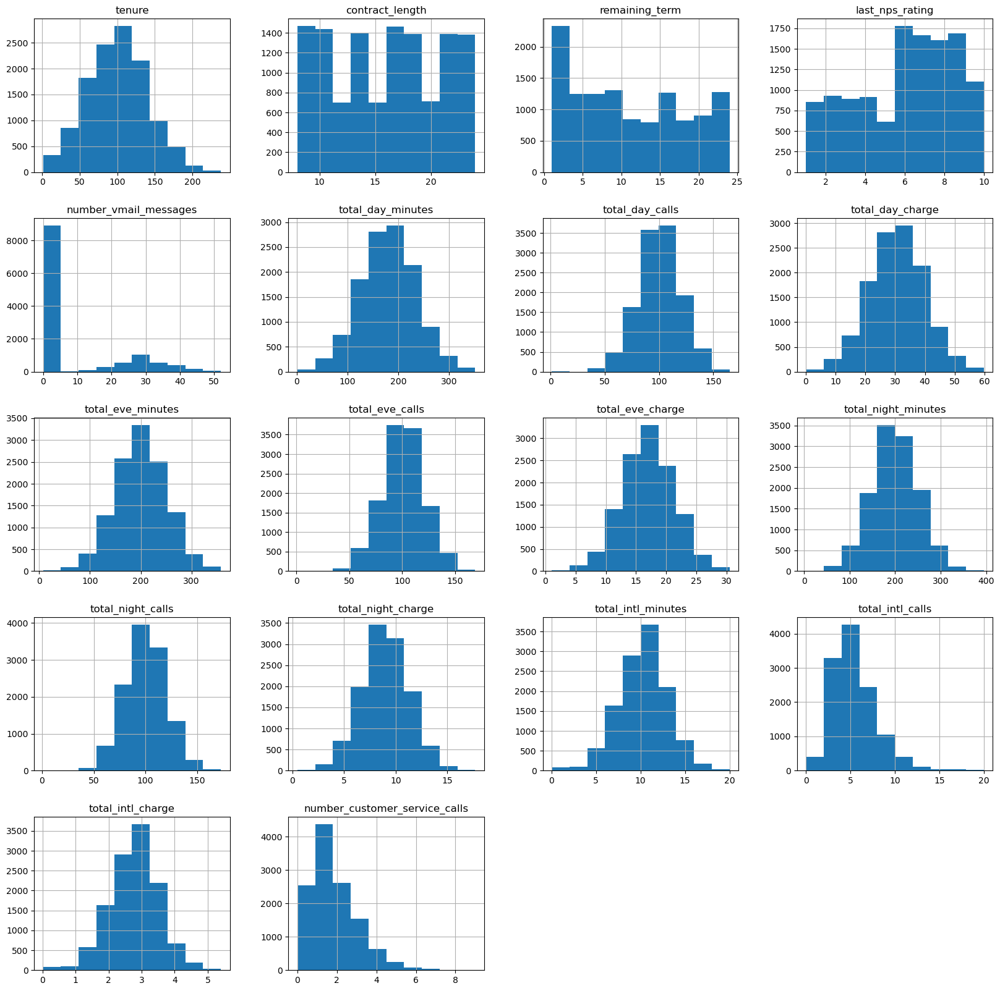

In [11]:
# plotting features
train.hist(figsize=(20, 20))
plt.show()

# EDA using Pandas Profiling

In [12]:
from ydata_profiling import ProfileReport

In [13]:
# create a new profile report
profile = ProfileReport(train, title="Train data Profiling report")

In [14]:
profile

# 1. Analysing categorical features

In [15]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

## Inspect target features

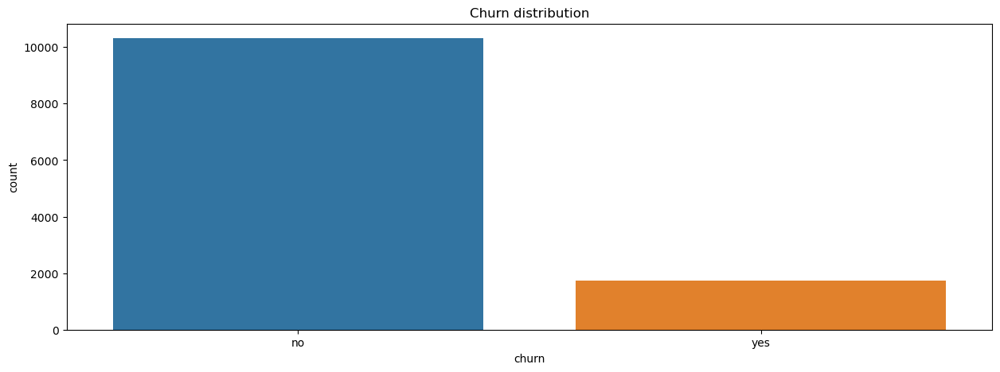

In [18]:
plt.figure(figsize=(15, 5))
sns.countplot(x="churn", data=train).set_title("Churn distribution")
plt.show()

# majority of customers still with our company, so false class more

## Inspect state, area code, promotions offered

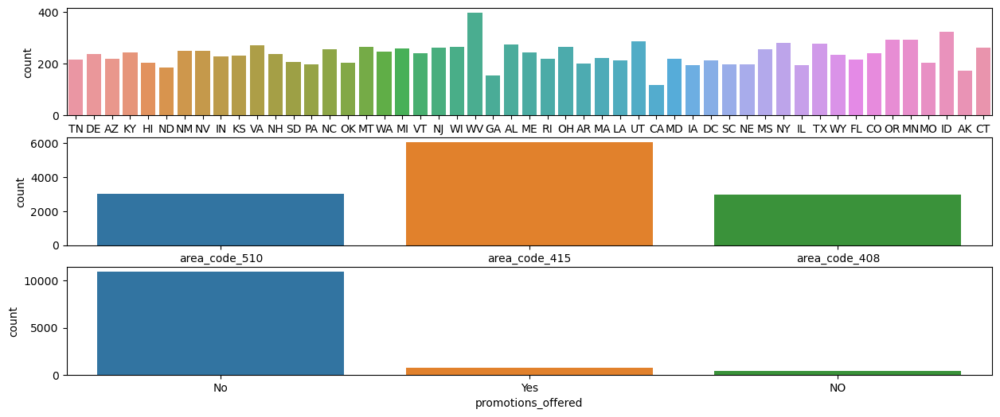

In [22]:
fig, axs = plt.subplots(3, figsize=(15, 6))
sns.countplot(data=train, x="state_code", ax=axs[0])
sns.countplot(data=train, x="area_code", ax=axs[1])
sns.countplot(data=train, x="promotions_offered", ax=axs[2])
plt.show()

There are 2 redundant classes in promotions_offered, need to take care of that.

# 2. Inspect numerical features

## Analyse vmail messages and customer service calls

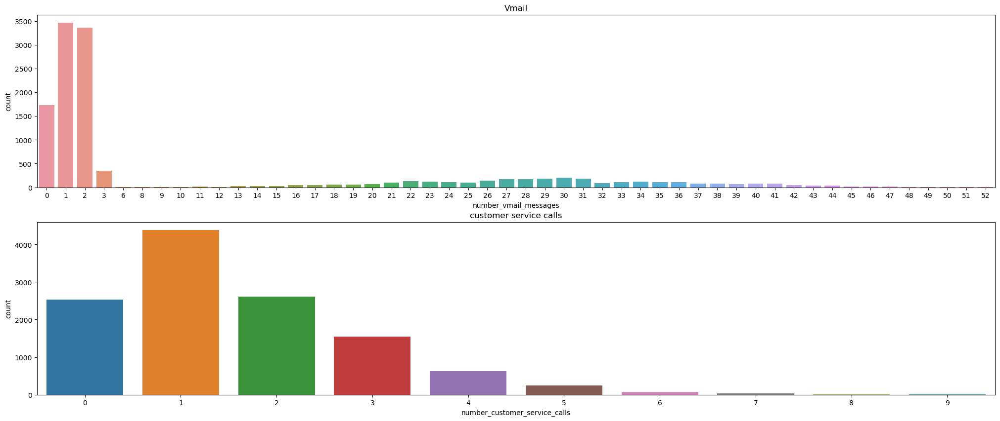

In [25]:
fig, axs = plt.subplots(2, figsize=(25, 10))
sns.countplot(x="number_vmail_messages", data=train, ax=axs[0]).set_title("Vmail")
sns.countplot(x="number_customer_service_calls", data=train, ax=axs[1]).set_title("customer service calls")
plt.show()

The customer service calls show a positive skew (tail is on the right side). A large majority of samples do not use vmail

## Analyse customer service calls given it's skewed

In [26]:
import numpy as np

In [28]:
# get skewdness
train["number_customer_service_calls"].skew()

# a positive value indicates higher weight in left tail

1.086776733503893

In [30]:
# applying transformation to make it closer to normally distributed
# adding 1 to ensure there are no 0s

train["log_number_customer_service_calls"] = np.log(train["number_customer_service_calls"]+1)

In [31]:
train["log_number_customer_service_calls"].skew()

-0.11828354478767099

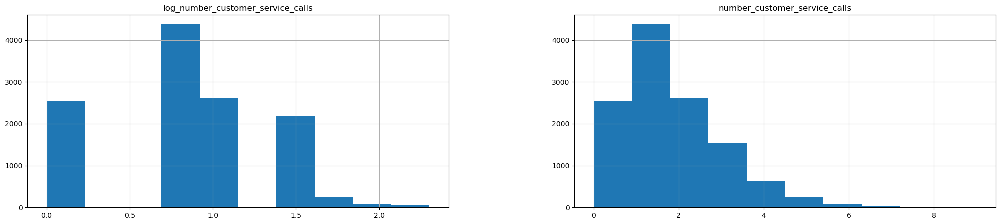

In [32]:
train[["log_number_customer_service_calls", "number_customer_service_calls"]].hist(figsize=(25, 5))
plt.show()

This column seems a bit more normally distributed

In [33]:
# drop column as we're still in the EDA phase
train.drop("log_number_customer_service_calls", axis=1, inplace=True)

In [36]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

# 3. Analyse Relationships

## Look into numeric/numeric correlation

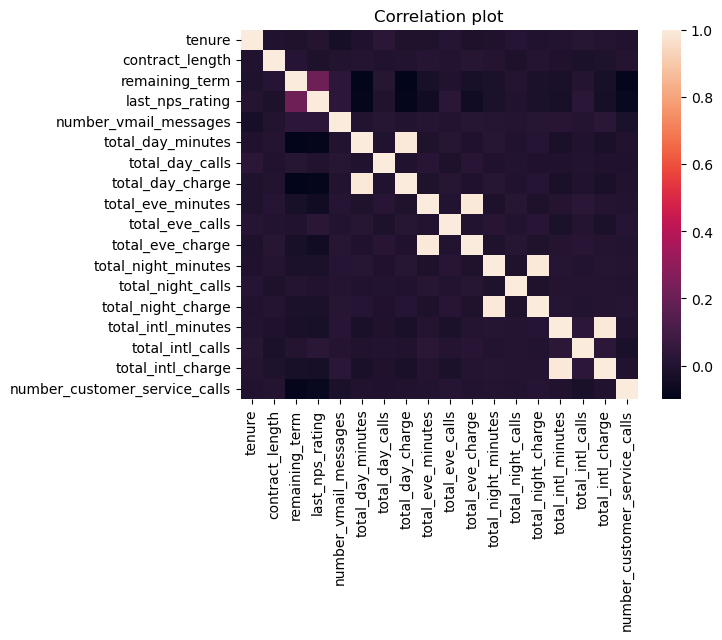

In [38]:
# visulising correlation values
sns.heatmap(train.select_dtypes(exclude="object").corr()).set_title("Correlation plot");

Correlation is seen between the charge and minutes. Feature correlation could hinder our model from converging, and reaching the optimal solution. So we need perform some feature engineering later on.

Churn is of dtype object right now, so convert it to numerical and observe correlations again

In [40]:
temp = train.copy()
temp["churn"] = temp["churn"].apply(lambda x: 1 if x=="yes" else 0)

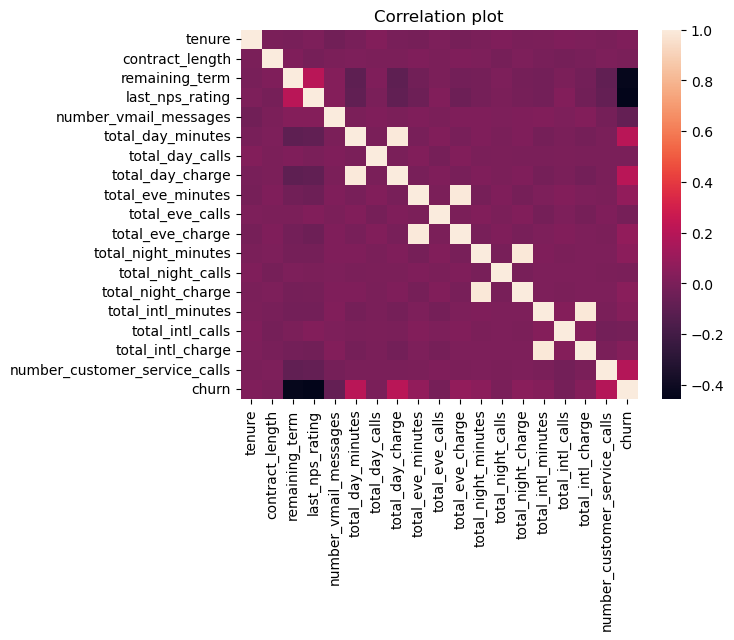

In [42]:
# heatmap on temp df
sns.heatmap(temp.select_dtypes(exclude="object").corr()).set_title("Correlation plot");

## Plot churn distributions

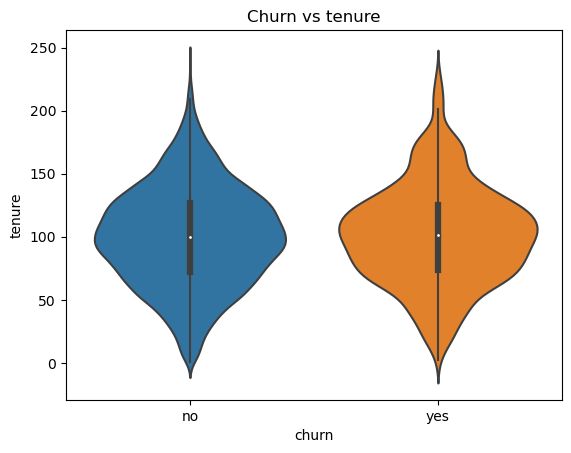

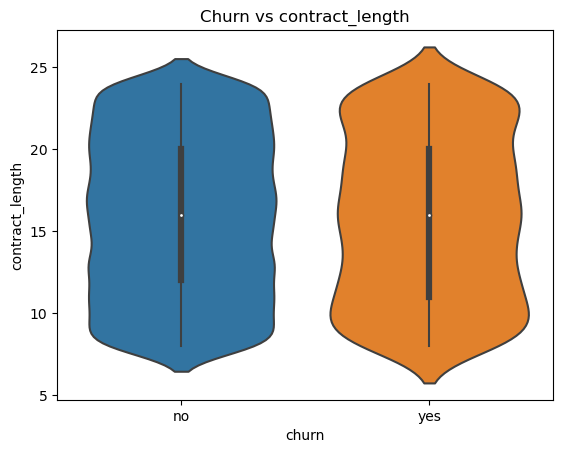

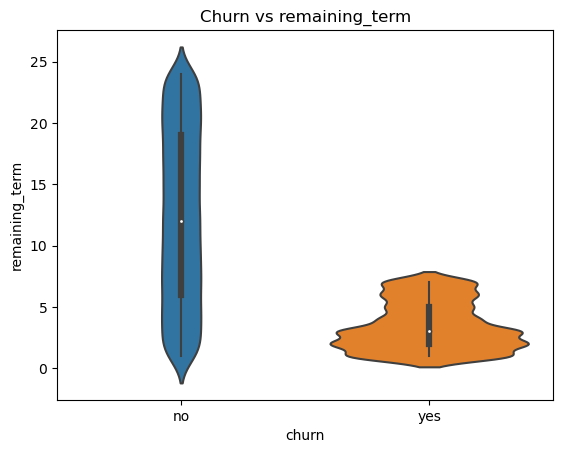

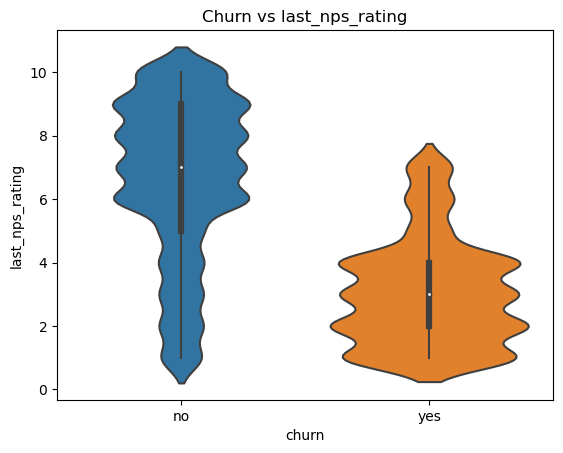

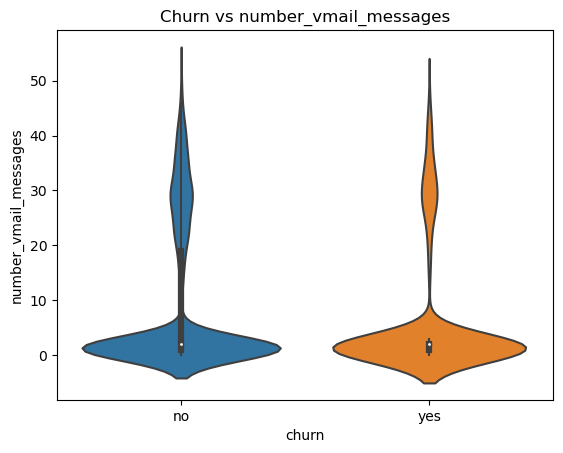

...

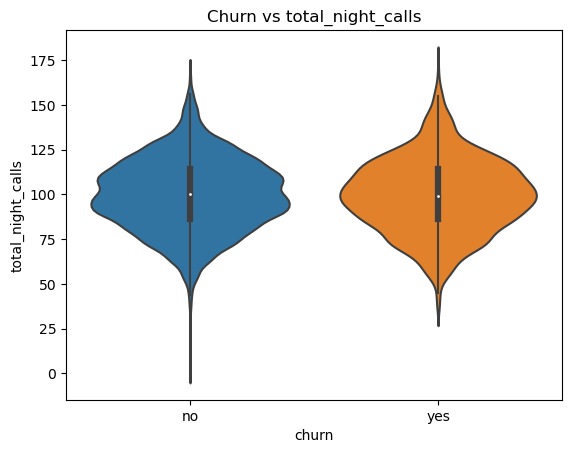

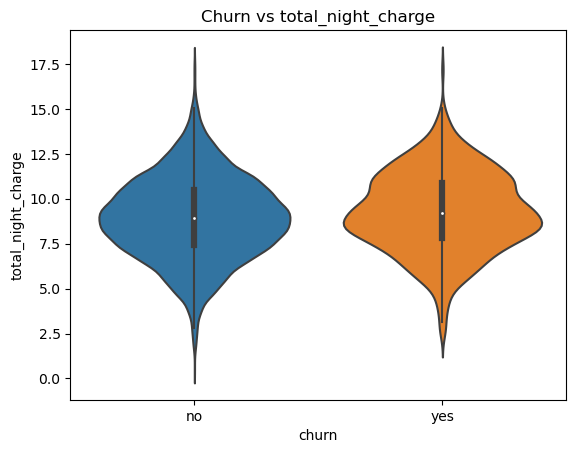

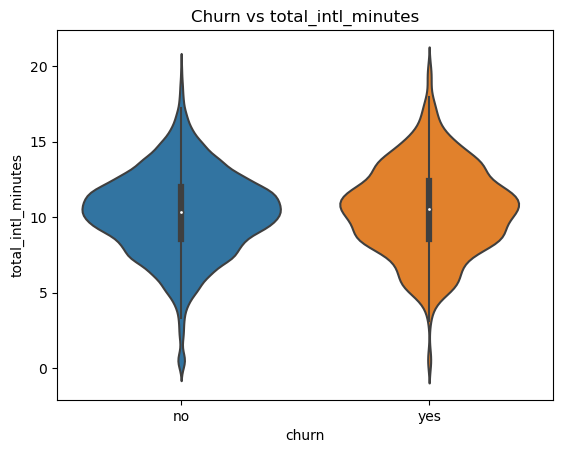

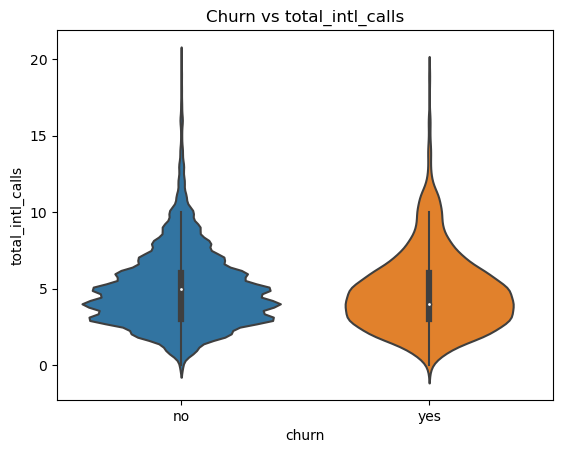

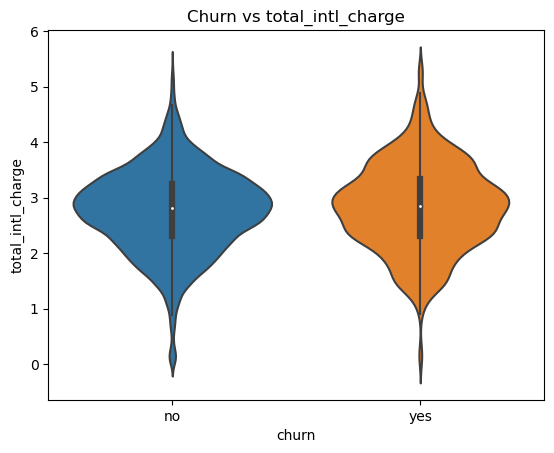

In [43]:
# plot each column vs churn
for col in train.select_dtypes(exclude="object").columns[:-1]:
    sns.violinplot(x="churn", y=col, data=train).set_title(f"Churn vs {col}")
    plt.show()

Last NPS rating and Remaining term seem to have a realtionship with churn

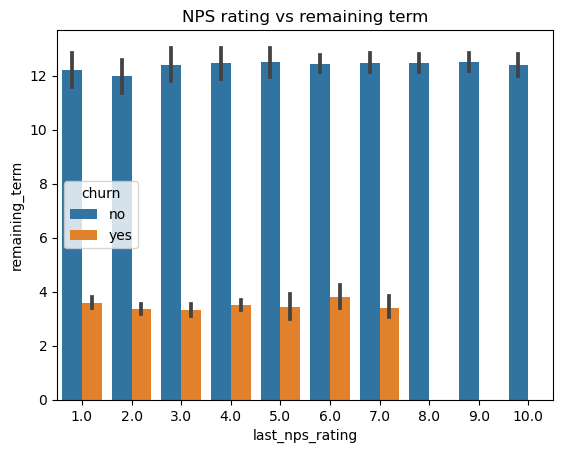

In [44]:
plt.title("NPS rating vs remaining term")
sns.barplot(x="last_nps_rating", y="remaining_term", hue="churn", data=train)
plt.show()

Customers who have churned typically have given an nps rating less than 8 and have a remaining term less than 5 months. This can be highlighted by engineering a new feature combining these both.

## Categorical relationships vs churn

In [46]:
train.promotions_offered.value_counts()
# fix this

No     10957
Yes      723
NO       361
Name: promotions_offered, dtype: int64

In [47]:
# Fill incorrectly labelled features 
train.promotions_offered = train.promotions_offered.replace(["NO", np.NaN], "No")

In [48]:
train.promotions_offered.value_counts()

No     11347
Yes      723
Name: promotions_offered, dtype: int64

In [49]:
pivot_feature = "promotions_offered"
pd.crosstab(train[pivot_feature], train["churn"])/len(train)

churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


11.6% of customers who have churned have not been offered a promotion

In [50]:
# what are out categorical values
train.select_dtypes(include='object').columns

Index(['state_code', 'promotions_offered', 'area_code', 'international_plan',
       'voice_mail_plan', 'churn'],
      dtype='object')

In [52]:
# crosstabs for every categorical feature
for col in train.select_dtypes(include='object').columns[:-1]:
    display(pd.crosstab(train[col], train["churn"])/len(train))

churn,no,yes
state_code,,
AK,0.013670,0.000829
AL,0.019553,0.002900
AR,0.014167,0.002403
AZ,0.016321,0.001657
CA,0.007539,0.002237
CO,0.017647,0.002237
CT,0.018558,0.003231
DC,0.014250,0.003065
DE,0.016239,0.003480


churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


churn,no,yes
area_code,,
area_code_408,0.210025,0.036205
area_code_415,0.430655,0.069097
area_code_510,0.213256,0.037780


churn,no,yes
international_plan,,
no,0.796935,0.108451
yes,0.057581,0.034631


churn,no,yes
voice_mail_plan,,
no,0.616321,0.118973
yes,0.237117,0.023529


## Relationship between remaining term and NPS rating? And promotions offered?

Namely when remaining term < 5 and last nps rating < 7

One hot encode these features

In [53]:
train["nps_less_7"] = (train["last_nps_rating"]<7).astype(int)
train["remaining_term_less_5"] = (train["remaining_term"]<5).astype(int)

In [55]:
# create 2 additional features for churn yes/no
train["churn_yes"] = train["churn"].apply(lambda x: 1 if x=="yes" else 0)
train["churn_no"] = train["churn"].apply(lambda x: 1 if x=="no" else 0)

In [56]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,nps_less_7,remaining_term_less_5,churn_yes,churn_no
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,9.332900,8.308312,9,2.208759,2,no,0,0,0,1
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,10.263007,8.238645,2,2.168779,1,yes,0,0,1,0
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,5.731597,11.084169,5,3.153671,0,no,0,0,0,1
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,9.407576,19.981388,4,5.242569,0,no,1,0,0,1
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,10.800377,11.670808,9,3.205746,2,no,0,0,0,1


In [64]:
# inspect features by grouping them
train.groupby(["nps_less_7", "remaining_term_less_5"]).sum(["churn_yes"])[["churn_yes", "churn_no"]] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.002320  0.410025
           1                       0.005385  0.084341
1          0                       0.041011  0.298260
           1                       0.094366  0.061889

9.4% of overall customers gave an nps rating less than 7 and had a remanining term less than 5 months, and churned

In [65]:
train.groupby(["nps_less_7", "remaining_term_less_5", "promotions_offered"]).sum(["churn_yes"])[["churn_yes", "churn_no"]] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.001988  0.410025
                                 Yes                  0.000331  0.000000
           1                     No                   0.004225  0.084341
                                 Yes                  0.001160  0.000000
1          0                     No                   0.033554  0.298260
                                 Yes                  0.007457  0.000000
           1                     No                   0.075891  0.029412
                                 Yes                  0.018476  0.032477

7.6% of overall customers had nps<7, remaining term<5 and did not have promotions, and churned

In [66]:
# drop created features
train.drop(["nps_less_7", "remaining_term_less_5", "churn_yes", "churn_no"], axis=1, inplace=True)

In [67]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,139,18.927987,217.002619,70,9.332900,8.308312,9,2.208759,2,no
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,124,16.126664,224.264014,89,10.263007,8.238645,2,2.168779,1,yes
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,109,20.911572,123.234534,87,5.731597,11.084169,5,3.153671,0,no
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,91,17.844030,215.835004,91,9.407576,19.981388,4,5.242569,0,no
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,103,12.536175,246.694873,130,10.800377,11.670808,9,3.205746,2,no
